# DFW Food Access: Data Collection

This report will focus on the food access in the Dallas/Fort Worth (DFW) metroplex in Texas.  I want to understand the availability of grocery stores and the density of fast food in DFW and how that relates to income levels.  I will be looking at ZIP Code level data in DFW to understand the relationship between income levels and food availability.  There are several sources we will look for this ZIP code level data: the US Census Bureau, the US Internal Revenue Service, and Foursquare.

In [28]:
import os
from typing import Optional
from zipfile import ZipFile
import math
import requests
import wget
import pandas as pd
import geopandas
from bs4 import BeautifulSoup
from IPython.display import clear_output
import folium

In [2]:
%%capture
from tqdm.notebook import tqdm
tqdm().pandas()

In [3]:
# Create a data directory
data_directory = "data"
if not os.path.isdir(data_directory):
    os.mkdir(data_directory)
print(f"Created the data directory at ./{data_directory}")

Created the data directory at ./data


Function below will be used to download zip files from the IRS and Census Bureau

In [4]:
def download_zipfile(url: str, filename: str, data_dir: str, sub_dir: str) -> Optional[str]:
    """ Download a zipfile from a url and extract it into the dir """    
  
    # Create download progress bar that works in Jupyter
    def notebook_progress_bar(current, total, width):
        """ This is adapted from wget so that we can see it in jupyter output """
        avail_dots = 60
        shaded_dots = int(math.floor(float(current) / total * avail_dots))
        clear_output(wait = True)
        print(f"Downloading the {filename} from {url}")
        print(f"[{'.'*shaded_dots}{' '*(avail_dots-shaded_dots)}] - {math.floor(100 * current/total)}% ({current}/{total} bytes)")
        
    # Download the file if not found in folder  
    if not os.path.isfile(f"{data_dir}/{filename}"):
        wget.download(url=f"{url}{filename}", out=data_dir, bar=notebook_progress_bar)
    else:
        print(f"{filename} is already downloaded and is located in ./{data_dir}")
        
    # unzip the archive
    path = f"{data_dir}/{sub_dir}"
    if not os.path.isdir(path):
        print(f"Unzipping the archive into {path}")
        with ZipFile(f"{data_dir}/{filename}", "r") as archive:
            archive.extractall(path)
    else:
        print(f"{filename} has already been unzipped and contents are located in ./{path}")

    return path

## DFW ZIP Codes

Firstly, we need to decide which ZIP Codes are in the DFW Metroplex.  From the website http://www.usa.com/dallas-fort-worth-arlington-tx-area-zip-code-and-maps.htm, they have collected a list of ZIP Coded that are considered in the DFW Metroplex with the 3 largest cites being Dallas, Fort Worth, and Arlington in between and then there are several surrounding cites that make up the greater metroplex that we will explore.  I will scrape this website using the BeautifulSoup package.

In [5]:
# get the DFW zipcodes from the webpage below
url = 'http://www.usa.com/dallas-fort-worth-arlington-tx-area-zip-code-and-maps.htm'
r = requests.get(url)
page = BeautifulSoup(r.text,'html.parser')
tags = page.select('div#rList4')[0].find_all('u')
dfw_metro_zipcodes=[tag.text.strip().split(",")[0] for tag in tags]
print(f"There are {len(dfw_metro_zipcodes)} ZIP codes listed on this website")

There are 400 ZIP codes listed on this website


## US Internal Revenue Service: Statistics of Income Tax Stats

The IRS puts out annual income stats gathered from tax returns as part of their SOI Tax Stats.  The IRS has ZIP code level individual income tax statistics data from 2001-2017.  We will focus on the most recent 2017 as all of the 2019 tax returns haven't even been filed yet and 2018 statistics are still being finalized.  Lets start by downloading the data.

In [6]:
# Download the IRS SOI Individual Income Tax ZIP Code Data from 2017
soi_data_path = download_zipfile(
    url = f"https://www.irs.gov/pub/irs-soi/",
    filename = f"zipcode2017.zip",
    data_dir=data_directory,
    sub_dir="irs-zipcode-2017"
)

zipcode2017.zip is already downloaded and is located in ./data
zipcode2017.zip has already been unzipped and contents are located in ./data/irs-zipcode-2017


In [7]:
# IRS SOI Individual Income Tax ZIP Code Data from 2017 with AGI included
irs_soi = pd.read_csv(f"{soi_data_path}/17zpallagi.csv")
irs_soi.head()

,STATEFIPS,STATE,zipcode,agi_stub,N1,mars1,MARS2,MARS4,ELF,CPREP,...,N85300,A85300,N11901,A11901,N11900,A11900,N11902,A11902,N12000,A12000
0,1,AL,0,1,802640.0,474470.0,99850.0,216600.0,717050.0,44090.0,...,0.0,0.0,64680.0,53602.0,700940.0,1803125.0,698100.0,1796343.0,2860.0,4917.0
1,1,AL,0,2,499070.0,218590.0,137460.0,129760.0,448190.0,26230.0,...,0.0,0.0,77660.0,118725.0,419640.0,1175607.0,416180.0,1165352.0,4250.0,8894.0
2,1,AL,0,3,268590.0,89780.0,134440.0,38280.0,241060.0,14160.0,...,0.0,0.0,67820.0,156752.0,201030.0,560461.0,197060.0,547812.0,5440.0,13482.0
3,1,AL,0,4,170880.0,32180.0,124070.0,11660.0,154120.0,7980.0,...,0.0,0.0,48440.0,141721.0,121930.0,396526.0,118460.0,383588.0,3160.0,12369.0
4,1,AL,0,5,229870.0,22810.0,196990.0,5540.0,208380.0,11120.0,...,50.0,19.0,91100.0,465160.0,138250.0,588068.0,130970.0,529001.0,8430.0,55564.0


In [8]:
irs_soi.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 166537 entries, 0 to 166536
Columns: 153 entries, STATEFIPS to A12000
dtypes: float64(149), int64(3), object(1)
memory usage: 194.4+ MB


As you can see this dataset is quite extensive with 153 different columns and over 194MB of data.  There is a word document at the website the explains each column at https://www.irs.gov/statistics/soi-tax-stats-individual-income-tax-statistics-2017-zip-code-data-soi.  We will refer to this later to find the data point we want to look at.   Lets subset this using the DFW ZIP Codes scraped from usa.com above.

In [9]:
dfw_mask = irs_soi['zipcode'].isin(dfw_metro_zipcodes)
dfw_soi = irs_soi[dfw_mask]
# Save dfw data
dfw_soi.to_csv(f"./{data_directory}/dfw_soi.csv")
print(f"Within the Union of 400 ZIP codes scrapes, there are {dfw_soi['zipcode'].unique().shape[0]} within the IRS data")

Within the Union of 400 ZIP codes scrapes, there are 259 within the IRS data


In [10]:
# drop this DataFrame from memory as we won't work with it in this notebook and it is 194.4+MB
del irs_soi

In [11]:
dfw_soi.head()

,STATEFIPS,STATE,zipcode,agi_stub,N1,mars1,MARS2,MARS4,ELF,CPREP,...,N85300,A85300,N11901,A11901,N11900,A11900,N11902,A11902,N12000,A12000
138532,48,TX,75001,1,2370.0,1770.0,200.0,360.0,2050.0,190.0,...,0.0,0.0,350.0,422.0,1920.0,3976.0,1900.0,3898.0,30.0,39.0
138533,48,TX,75001,2,2440.0,1770.0,270.0,340.0,2190.0,130.0,...,0.0,0.0,420.0,809.0,2000.0,4352.0,1980.0,4309.0,30.0,43.0
138534,48,TX,75001,3,1680.0,1270.0,260.0,110.0,1480.0,110.0,...,0.0,0.0,390.0,1067.0,1280.0,2985.0,1260.0,2900.0,40.0,138.0
138535,48,TX,75001,4,940.0,640.0,250.0,40.0,830.0,60.0,...,0.0,0.0,270.0,851.0,670.0,1853.0,650.0,1800.0,0.0,0.0
138536,48,TX,75001,5,1320.0,650.0,580.0,70.0,1180.0,90.0,...,0.0,0.0,510.0,2873.0,810.0,4024.0,760.0,3072.0,60.0,628.0


From the document on the IRS SOI website, we find that this data is stratified by Adjusted Gross Income (AGI) which will be nice to see distributions of income levels.  The column agi_stub is numbered 1-6 with each number representing the AGI ranges below:

- 1 = \\$1 under \\$25,000
- 2 = \\$25,000 under \\$50,000
- 3 = \\$50,000 under \\$75,000
- 4 = \\$75,000 under \\$100,000
- 5 = \\$100,000 under \\$200,000
- 6 = \\$200,000 or more

## US Census Bureau ZIP Code Tabulation Areas

> *ZIP Code Tabulation Areas (ZCTAs) are generalized areal representations of United States Postal Service (USPS) ZIP Code service areas.*

This dataset will provide us with the shapefiles to give a geographic representation of the ZIP code areas.  This will help in mapping the areas and creating choropleth maps to visualize the data.  Also, the shapefiles will give me search boundaries to look for venues in each ZIP code using the Foursquare API.  Now there are some issues with using ZIP codes for geospacial analysis as ZIP codes do not represent boundaries, but rather the USPS delivery routes.  The website https://smartystreets.com/docs/zip-codes-101 gives a good simple overview of the ZIP code nomenclature with the first digit represent the national area, the next two digits representing a regional center, and the last two representing a local post office or delivery area.  

Using actual addresses would be the absolute best geospacial unit because this would provide the best detail.  Most counties tax appraisal offices in Texas have great data as this is Texas government's main source of income as there is no state income tax.  Within the property tax data, there is no collection of owner's income, but home values could have the potential of being a good indicator of owner income as many people tend to buy homes according to their income.  Home values have increased significantly in the past 10 years in the DFW area, and in some cases, incomes could have stayed stagnant or even declined so the proportionality would be skewed in these cases.  For this study, I will focus around the IRS SOI ZIP code data as it provides a wealth of income data even if the ZCTA is not the best unit for geospacial analysis.

In [12]:
# Download the Census Buearu ZCTA (The progress bar does not work for this and it will take a long time at over 500MB)
zcta_data_path = download_zipfile(
    url = f"https://www2.census.gov/geo/tiger/TIGER2019/ZCTA5/",
    filename = f"tl_2019_us_zcta510.zip",
    data_dir=data_directory,
    sub_dir="census-zcta"
)

tl_2019_us_zcta510.zip is already downloaded and is located in ./data
tl_2019_us_zcta510.zip has already been unzipped and contents are located in ./data/census-zcta


In [13]:
us_geo = geopandas.read_file(f"./{zcta_data_path}/tl_2019_us_zcta510.shp")
us_geo.head()

,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry
0,43451,43451,B5,G6350,S,63484186,157689,+41.3183010,-083.6174935,"POLYGON ((-83.70873 41.32733, -83.70815 41.327..."
1,43452,43452,B5,G6350,S,121522304,13721730,+41.5157923,-082.9809454,"POLYGON ((-83.08698 41.53780, -83.08256 41.537..."
2,43456,43456,B5,G6350,S,9320975,1003775,+41.6318300,-082.8393923,"MULTIPOLYGON (((-82.83558 41.71082, -82.83515 ..."
3,43457,43457,B5,G6350,S,48004681,0,+41.2673301,-083.4274872,"POLYGON ((-83.49650 41.25371, -83.48382 41.253..."
4,43458,43458,B5,G6350,S,2573816,39915,+41.5304461,-083.2133648,"POLYGON ((-83.22229 41.53102, -83.22228 41.532..."


In [55]:
# convert the zipcode to as int so that is matches the ISR data
us_geo["ZCTA5CE10"] = us_geo["ZCTA5CE10"].astype(int)
us_geo.info()

<class 'geopandas.geodataframe.GeoDataFrame'>
RangeIndex: 33144 entries, 0 to 33143
Data columns (total 10 columns):
 #   Column      Non-Null Count  Dtype   
---  ------      --------------  -----   
 0   ZCTA5CE10   33144 non-null  int64   
 1   GEOID10     33144 non-null  object  
 2   CLASSFP10   33144 non-null  object  
 3   MTFCC10     33144 non-null  object  
 4   FUNCSTAT10  33144 non-null  object  
 5   ALAND10     33144 non-null  int64   
 6   AWATER10    33144 non-null  int64   
 7   INTPTLAT10  33144 non-null  object  
 8   INTPTLON10  33144 non-null  object  
 9   geometry    33144 non-null  geometry
dtypes: geometry(1), int64(3), object(6)
memory usage: 2.5+ MB


In [56]:
# subset the ZCTA to include only the intersection of the dfw_soi dataset
dfw_mask = us_geo["ZCTA5CE10"].isin(dfw_soi["zipcode"].astype(str).unique())
dfw_geo = us_geo[dfw_mask]
# Save DFW ZIP Code Shapefile
dfw_geo.to_file(f"./{data_directory}/dfw_zcta.shp")
dfw_geo.head()

,ZCTA5CE10,GEOID10,CLASSFP10,MTFCC10,FUNCSTAT10,ALAND10,AWATER10,INTPTLAT10,INTPTLON10,geometry
178,75098,75098,B5,G6350,S,85315034,20354151,+33.0121346,-096.5349358,"POLYGON ((-96.60198 33.01127, -96.60061 33.011..."
182,75104,75104,B5,G6350,S,101138796,643670,+32.5848142,-096.9723118,"POLYGON ((-97.06551 32.54908, -97.06427 32.549..."
186,75114,75114,B5,G6350,S,112014042,1126841,+32.6105754,-096.4442563,"POLYGON ((-96.50103 32.49728, -96.50101 32.497..."
187,75115,75115,B5,G6350,S,56804463,85455,+32.5994271,-096.8640746,"POLYGON ((-96.90840 32.61879, -96.90560 32.618..."
188,75116,75116,B5,G6350,S,13264638,15027,+32.6606604,-096.9118821,"POLYGON ((-96.94325 32.66178, -96.94323 32.662..."


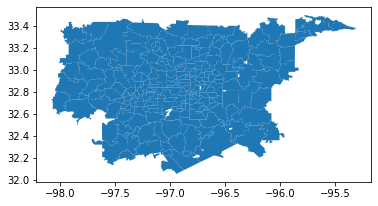

In [57]:
# Quick plot of the shapefile fo rthe DFW Metroplex
dfw_geo.plot()

## SOI Income Tax Data in DFW

Create a function to create choropleths for DFW.

In [98]:
def dfw_choropleth(df: pd.DataFrame, zip_key: str, col: str):
    """ Create Choropleth Map of DFW using the provided data, the zipcode col key, and the column to visualize  """
    tx_map = folium.Map(location=[32.7357, -97.1081], tiles = "Stamen Toner", zoom_start=9)
    folium.Choropleth(
        geo_data=dfw_geo,
        data=df,
        columns=[zip_key,col],
        key_on='feature.properties.ZCTA5CE10',
        fill_color='BuGn',
        line_color='#00285e',
        fill_opacity=0.8,
        line_opacity=1,
        highlight=True
    ).add_to(tx_map)
    folium.LayerControl().add_to(tx_map)

    return tx_map

### Map of the percent of 2017 tax returns filed in a ZIP Code where the agi was between \\$1 and \\$25,000

In [101]:
dfw_soi["ratio_N1"] = dfw_soi.groupby('zipcode')['N1'].transform(lambda x: x/x.sum())
dfw_choropleth(dfw_soi[dfw_soi['agi_stub']==1], 'zipcode', 'ratio_N1')

### Map of the percent of 2017 tax returns filed in a ZIP Code which had unemployment compensation

In [108]:
unemp = dfw_soi.groupby('zipcode')[['N1','A02300']].sum().apply(lambda x: x['A02300']/x['N1'], axis=1).reset_index()
dfw_choropleth(unemp, 'zipcode', 0)

### Map of the percent of 2017 tax returns filed in a ZIP Code with earned income credit

In [110]:
eic = dfw_soi.groupby('zipcode')[['N1','N59660']].sum().apply(lambda x: x['N59660']/x['N1'], axis=1).reset_index()
dfw_choropleth(eic, 'zipcode', 0)

The final data to collect is the venue data from the Foursquare API.  This will be done in separate notebook.